In [ ]:
from sae.hooked_prisma.main import setup
import os
import sys
import torch
import torch.nn.functional as F
import json
import plotly.express as px
from transformer_lens import utils
from datasets import load_dataset
from typing import Dict
from pathlib import Path

from functools import partial
#temp
from sae.hooked_prisma.vision_config import VisionModelRunner

if torch.backends.mps.is_available():
    device = "mps"
else:
    device = "cuda" if torch.cuda.is_available() else "cpu"
print(device)
torch.set_grad_enabled(False)




In [ ]:
cfg ,model, activations_loader, sae_group = setup(pretrained_path=r"F:\ViT-Prisma_fork\data\vision_sae_checkpoints\try1_9.pt")



In [ ]:
for i, sae in enumerate(sae_group):
    hyp = sae.cfg
    print(
        f"{i}: Layer {hyp.hook_point_layer}, p_norm {hyp.lp_norm}, alpha {hyp.l1_coefficient}"
    )

In [ ]:
# pick which sae you wnat to evaluate. Default is 0 (only option in this case)
sparse_autoencoder = sae_group.autoencoders[0]

## Test the Autoencoder


### L0 Test

In [ ]:
sparse_autoencoder.eval()  # prevents error if we're expecting a dead neuron mask for who grads
with torch.no_grad():
    batch_tokens, labels = activations_loader.get_val_batch_tokens()
    _, cache = model.run_with_cache(batch_tokens)
    sae_out, feature_acts, loss, mse_loss, l1_loss, _ = sparse_autoencoder(
        cache[sparse_autoencoder.cfg.hook_point]
    )
    del cache

    # ignore the bos token, get the number of features that activated in each token, averaged accross batch and position
    l0 = (feature_acts[:, 1:] > 0).float().sum(-1).detach()
    print("average l0", l0.mean().item())
    px.histogram(l0.flatten().cpu().numpy()).show()

### Reconstruction test

In [ ]:
# next we want to do a reconstruction test.
def reconstr_hook(activation, hook, sae_out):
    return sae_out


def zero_abl_hook(activation, hook):
    return torch.zeros_like(activation)

# orig
class_logits = model(batch_tokens)
loss = F.cross_entropy(class_logits, labels)
print("Orig", loss.item())
# reconstr
class_logts_reconstr = model.run_with_hooks(
        batch_tokens,
        fwd_hooks=[
            (
                utils.get_act_name("resid_pre", 10),
                partial(reconstr_hook, sae_out=sae_out),
            )
        ])
loss_reconstr = F.cross_entropy(class_logts_reconstr, labels)
print("reconstr",loss_reconstr.item())

class_logts_zero = model.run_with_hooks(
        batch_tokens,
        fwd_hooks=[(utils.get_act_name("resid_pre", 10), zero_abl_hook)],
    )
loss_zero = F.cross_entropy(class_logts_zero, labels)


print("Zero", loss_zero.item())

## Specific Capability Test

Validating model performance on specific tasks when using the reconstructed activation is quite important when studying specific tasks.


In [ ]:

imagenet_class_index = r'F:\ViT-Prisma_fork\ViT-Prisma\data\imagenet_class_index.json'
with open(imagenet_class_index, 'r') as file:
    imagenet_class_index_data = json.load(file)
ind_to_name = {int(k):v[1] for k, v in imagenet_class_index_data.items()}


def top_n(logits, n):
    probs = torch.softmax(logits, dim=0)  # Assuming logits are 1D, use dim=-1 for batched operations
    
    # Find the top n probabilities and their indices
    top_probs, top_indices = torch.topk(probs, n)
    
    return top_indices, top_probs
    pass

class_logits = model(batch_tokens)

class_logts_reconstr = model.run_with_hooks(
        batch_tokens,
        fwd_hooks=[
            (
                utils.get_act_name("resid_pre", 10),
                partial(reconstr_hook, sae_out=sae_out),
            )
        ])
n=5
for gt, cl, clr in zip(labels, class_logits, class_logts_reconstr):

    top_n_ind, top_n_prob = top_n(cl, n)

    top_n_ind_r, top_n_prob_r = top_n(clr,n)

    print("GROUND TRUTH", ind_to_name[gt.item()])
    print("default")    
    print("-------")

    for i, (ind, p) in enumerate(zip(top_n_ind, top_n_prob)):
        print(f"{i+1} {p.item()*100:05.2f}% {ind_to_name[ind.item()]}")
    print("reconstruct")    
    print("-------")

    for i, (ind, p) in enumerate(zip(top_n_ind_r, top_n_prob_r)):
        print(f"{i+1} {p.item()*100:05.2f}% {ind_to_name[ind.item()]}")

    print("===================")



# Generating Feature Interfaces (TODO)


In [ ]:
vals, inds = torch.topk(feature_acts[0, 0].detach().cpu(), 10) 
px.bar(x=[str(i) for i in inds], y=vals).show()

## Top activations

In [ ]:
import pandas as pd
import torch
from torchvision import datasets, transforms
from torch.utils.data import DataLoader, Subset, Dataset
import os
import random
import matplotlib.pyplot as plt
import numpy as np
import json
from tqdm import tqdm
from einops import rearrange, repeat
import base64
from sae.hooked_prisma.main import ImageNetValidationDataset
import torchvision


BATCH_INDEX = 'batch_index'
IMAGE_INDEX = 'image_index'
GT_CLASS = 'gt_class'
PRED_CLASS = 'pred_class'
PATCH_INDEX = 'patch_index'
NEURON_INDEX = 'feature_index'
ACTIVATION_VALUE = 'activation'


In [79]:
MAX = 50_000 #TODO I think this isn't needed as of now (so should be full size of dataset)
batch_size = 16

In [80]:



data_transforms = torchvision.transforms.Compose([
    torchvision.transforms.Resize((224, 224)),
    torchvision.transforms.ToTensor(),
])
imagenet_data = ImageNetValidationDataset(r'F:\prisma_data\imagenet-object-localization-challenge\ILSVRC\Data\CLS-LOC\val',
                                          r'F:\ViT-Prisma_fork\ViT-Prisma\data\imagenet_class_index.json',
                                            r"F:\prisma_data\imagenet-object-localization-challenge\LOC_val_solution.csv",
                                            data_transforms)

image_samples = np.random.choice(len(imagenet_data), MAX, replace=False) 

    
imagenet_data = Subset(imagenet_data, image_samples)

class ReturnIndexDatasetWrapper(Dataset):

    def __init__(self, dataset):
        self.dataset = dataset

    def __len__(self):
        return len(self.dataset)
    
    def __getitem__(self, index):
        img, label = self.dataset[index]
        return img, label ,index 
    

imagenet_data = ReturnIndexDatasetWrapper(imagenet_data)    
data_loader = DataLoader(imagenet_data, batch_size=batch_size, shuffle=False)

In [ ]:




# def process_images(model, total_images, total_labels, image_indices, batch_idx, detach=True, flatten=True):


#     with torch.no_grad():
#         logits_per_image, cache = model.run_with_cache(total_images)
#         sae_out, feature_acts, loss, mse_loss, l1_loss, _ = sparse_autoencoder(
#             cache[sparse_autoencoder.cfg.hook_point]
#         )
#         del cache 

#     probs = logits_per_image.softmax(dim=1)  # we can take the softmax to get the label probabilities
#     class_indices = probs.argmax(dim=1)
#     total_labels = total_labels.to(class_indices.device)

#     #TODO!! deal with extra 
#     batch_activations = feature_acts[:, 1:, :]

#    # TODO Better than looping but maybe could be restructured entirely? (batch_idx, image_idx, class_name, predicted are all constants per batch moreoever they are int. patch_idx, neuron_idx could be infered from shape. Should probably just return activations + 'constants' and figure out the rest when trying to convert to panda?). Intstead I'm trying to mimic the exact format of the old list in a float tensor.... :O


#     b, p, n = batch_activations.shape
#     dt = batch_activations.dtype
#     dev = batch_activations.device

#     patch_index = torch.arange(p, dtype=dt).to(dev)
#     neuron_index = torch.arange(n, dtype=dt).to(dev)

#     patch_index, neuron_index = torch.meshgrid(patch_index, neuron_index, indexing='ij')
#     patch_index = repeat(patch_index, 'h w -> b h w 1', b=b)
#     neuron_index = repeat(neuron_index, 'h w -> b h w 1', b=b)

#     batch_indices = torch.full_like(neuron_index, fill_value=batch_idx)
#     image_indices = torch.tensor(image_indices, dtype=dt).to(dev)

#     image_indices = repeat(image_indices, 'b -> b h w 1', h=p, w=n)
#     gt_class_indices = repeat(total_labels, 'b -> b h w 1', h=p, w=n)
#     pred_class_indices =  repeat(class_indices, 'b -> b h w 1', h=p, w=n)


#     activations_table =torch.concatenate([batch_indices, image_indices,gt_class_indices,pred_class_indices,  patch_index, neuron_index,batch_activations.unsqueeze(-1)], dim=-1)
#     if flatten:
#         activations_table = rearrange(activations_table, 'b h w c -> (b h w) c')
#     if detach:
#         activations_table = activations_table.detach().cpu()
#     return activations_table

# def tensor_activations_to_panda(activations, verbose=True, convert_to_string=False):


    
#     df_activations = pd.DataFrame(activations)



#     # Assign column names
#     df_activations.columns = [ BATCH_INDEX, IMAGE_INDEX, GT_CLASS, PRED_CLASS, PATCH_INDEX, NEURON_INDEX, ACTIVATION_VALUE ]

#     # convert everything but activation to int
#     for int_names in df_activations.columns[:-1]:
#         df_activations[int_names] = df_activations[int_names].astype(int)

#     # convert class indices to string names (a bit slow)
#     if convert_to_string:
#         if verbose:
#             print("converting to string...")
#         #TODO only do this when actually displaying something
#         df_activations[GT_CLASS] = df_activations[GT_CLASS].map(lambda x: ind_to_name[x])
#         df_activations[PRED_CLASS] = df_activations[PRED_CLASS].map(lambda x: ind_to_name[x])
#         if verbose:
#             print("converting done.") 

#     return df_activations

# def process_images_to_panda(model, total_images, total_labels, image_indices, batch_idx, verbose=False, convert_to_string=False):
#     return tensor_activations_to_panda(process_images(model, total_images, total_labels, image_indices, batch_idx), verbose=verbose, convert_to_string=convert_to_string)


In [ ]:



# master_layer_activations = []


# count = 0


# for batch_idx, (total_images, total_labels, total_indices) in tqdm(enumerate(data_loader), total=MAX//batch_size):
#         total_images = total_images.to(device)
#         detailed_activations = process_images(model, total_images, total_labels, total_indices, batch_idx=batch_idx)
#         master_layer_activations.append(detailed_activations)

#         count += batch_size
#         if count >= MAX:
#             break



# activations = torch.cat(master_layer_activations, dim=0)


# df_activations = tensor_activations_to_panda(activations)

# print("sorting..")
# #TODO pytorch sort?
# sorted = df_activations.sort_values(by=[ACTIVATION_VALUE], ascending=False, inplace=False)
# print("sorting done")


# if save_activations:
#     #TODO option to load
#     df_activations.to_parquet(parquet_file_path.format(layer_num), index=False)

In [ ]:
#sorted.head(100)

In [ ]:
# def plot_image_patch_heatmap(images, heatmaps, titles=None, main_title="" ,width=4, alpha=0.4, save=None):
#     if titles is None:
#         titles = [''] * len(images)

#     assert len(images) == len(heatmaps) == len(titles), "Images, heatmaps, and titles must have the same length."
    
#     num_images = len(images)
#     height = int(np.ceil(num_images/width))
#     if height == 1:
#         width = num_images
#     fig, axes = plt.subplots(height, width, figsize=(5*width, 5*height))

#     fig.suptitle(main_title, fontsize=12)

#     if num_images == 1:
#         axes = np.array([[axes]])
   

    
#     for idx, (image, heatmap, title) in enumerate(zip(images, heatmaps, titles)):
#         ax = axes.flatten()[idx]
        
#         image_size = image.shape[-1]
#         pixel_num = heatmap.shape[-1]

#         # Create a heatmap overlay
#         heatmap_expanded = np.zeros((image_size, image_size))
#         patch_size = image_size // pixel_num

#         for i in range(pixel_num):
#             for j in range(pixel_num):
#                 heatmap_expanded[i*patch_size:(i+1)*patch_size, j*patch_size:(j+1)*patch_size] = heatmap[i, j]

#         # Plotting the image with the heatmap overlay
#         ax.imshow(image.permute(1, 2, 0))
#         ax.imshow(heatmap_expanded, cmap='viridis', alpha=0.6)  # Overlaying the heatmap
#         ax.axis('off')  
        
#         min_activation = heatmap.min()
#         max_activation = heatmap.max()



#         ax.set_title(title)

#     # Hide any remaining subplots that don't have data
#     for ax in axes.flatten()[num_images:]:
#         ax.axis('off')
    
#     plt.tight_layout()

#     if save is not None:
#         plt.savefig(save)

#     plt.show()

# def get_activation_array(image_idx, neuron_idx, activations, pixel_num=14):

#     filtered_df = activations[(activations[IMAGE_INDEX] == image_idx) &
#                             (activations[NEURON_INDEX] == neuron_idx)]

#     activation_values = filtered_df[ACTIVATION_VALUE]

#     activation_values_array = activation_values.to_numpy()# TODO!!! bring this back[1:]
#     activation_values_array = activation_values_array.reshape(pixel_num, pixel_num)

#     return activation_values_array

# def plot_activations_heatmap(image_indices, neuron_indices, titles, main_title="", activations=df_activations, dataset=imagenet_data , pixel_num=14, alpha=0.4, save=None):
#     images = []
#     heatmaps = []
#     for image_idx, neuron_idx in zip(image_indices, neuron_indices):

        
#         image = dataset[image_idx][0]


#         images.append(image)
#         heatmaps.append(get_activation_array(image_idx, neuron_idx, activations, pixel_num) )
    
#     plot_image_patch_heatmap(images, heatmaps, titles, main_title=main_title, alpha=alpha, save=save)

In [ ]:
# output_folder = "F:/newTemp/um"
# os.makedirs(output_folder, exist_ok=True)

# interesting_neurons = [46597,30319]
# top_n = 3
# for neuron_idx in  interesting_neurons:

#     df_activations = df_activations
#     df_sorted = sorted
#     #TODO why drop duplicates?
#     unique_top_entries = df_sorted[df_sorted[NEURON_INDEX] == neuron_idx].drop_duplicates(subset=GT_CLASS).head(top_n)

#     images, titles = [], []
#     for i, (image_index, class_name) in enumerate(zip(unique_top_entries[IMAGE_INDEX], unique_top_entries[GT_CLASS])):
#         title = f"Image: {image_index}\nClass: {class_name}"
#         images.append(image_index)
#         titles.append(title)
#     main_title = f"ACTIVATIONS\nNeuron: {neuron_idx}"
#     plot_activations_heatmap(images, [neuron_idx]*len(images), titles, main_title=main_title, activations=df_activations, dataset=imagenet_data, save=os.path.join(output_folder, f"{neuron_idx:04d}_activations.jpg"))

### ARENA stuff

https://arena3-chapter1-transformer-interp.streamlit.app/[1.4]_Superposition_&_SAEs
first getting feature probability

In [ ]:
import einops

In [ ]:

update_layout_set = {"xaxis_range", "yaxis_range", "hovermode", "xaxis_title", "yaxis_title", "colorbar", "colorscale", "coloraxis", "title_x", "bargap", "bargroupgap", "xaxis_tickformat", "yaxis_tickformat", "title_y", "legend_title_text", "xaxis_showgrid", "xaxis_gridwidth", "xaxis_gridcolor", "yaxis_showgrid", "yaxis_gridwidth", "yaxis_gridcolor", "showlegend", "xaxis_tickmode", "yaxis_tickmode", "margin", "xaxis_visible", "yaxis_visible", "bargap", "bargroupgap", "coloraxis_showscale"}
def to_numpy(tensor):
    """
    Helper function to convert a tensor to a numpy array. Also works on lists, tuples, and numpy arrays.
    """
    if isinstance(tensor, np.ndarray):
        return tensor
    elif isinstance(tensor, (list, tuple)):
        array = np.array(tensor)
        return array
    elif isinstance(tensor, (torch.Tensor, torch.nn.parameter.Parameter)):
        return tensor.detach().cpu().numpy()
    elif isinstance(tensor, (int, float, bool, str)):
        return np.array(tensor)
    else:
        raise ValueError(f"Input to to_numpy has invalid type: {type(tensor)}")

def hist(tensor, renderer=None, **kwargs):
    '''
    '''
    kwargs_post = {k: v for k, v in kwargs.items() if k in update_layout_set}
    kwargs_pre = {k: v for k, v in kwargs.items() if k not in update_layout_set}
    if "bargap" not in kwargs_post:
        kwargs_post["bargap"] = 0.1
    if "margin" in kwargs_post and isinstance(kwargs_post["margin"], int):
        kwargs_post["margin"] = dict.fromkeys(list("tblr"), kwargs_post["margin"])
    px.histogram(x=to_numpy(tensor), **kwargs_pre).update_layout(**kwargs_post).show(renderer)



In [81]:
@torch.no_grad()
def get_feature_probability(
    images,
    model,
    sparse_autoencoder,
):
    '''
    Returns the feature probabilities (i.e. fraction of time the feature is active) for each feature in the
    autoencoder, averaged over all `batch * seq` tokens.
    '''
    batch_size = images.shape[0]
    _, cache = model.run_with_cache(images)
    sae_out, feature_acts, loss, mse_loss, l1_loss, _ = sparse_autoencoder(
        cache[sparse_autoencoder.cfg.hook_point]
    )
    # _, cache = model.run_with_cache(tokens, names_filter = ["blocks.0.mlp.hook_post"])
    # post = cache["blocks.0.mlp.hook_post"]

    post_reshaped = einops.repeat(feature_acts, "batch seq d_mlp -> (batch seq) d_mlp")

    

    return post_reshaped.mean(0)
# Get a batch of feature probabilities & average them (so we don't put strain on the GPU)

total = None

this_max = 50000
count = 0
for batch_idx, (total_images, total_labels, total_indices) in tqdm(enumerate(data_loader), total=this_max//batch_size):
        total_images = total_images.to(device)
        new = get_feature_probability(total_images, model, sparse_autoencoder)

        if total is None:
             total = new
        else:
             total = total + new 


        if batch_idx*batch_size >= this_max:
            break


100%|██████████| 3125/3125 [14:48<00:00,  3.52it/s]


In [82]:
feature_probability = total/(this_max//batch_size)

log_freq = (feature_probability + 1e-10).log10()

# Visualise sparsities for each instance
hist(
    log_freq,
    title=f"Log Frequency of Features",
    labels={"x": "log<sub>10</sub>(freq)"},
    histnorm="percent",
    template="ggplot2"
)

Notes: huge amount of dead neurons? Language example had two clear peaks, one like what I have the other low prop around -4/-5

Next arena looks at reconstruction and substitution loss. Something similar was done above.

In [83]:

def get_reconstruction_loss(
    images,
    model,
    autoencoder,
):
    '''
    Returns the reconstruction loss of each autoencoder instance on the given batch of tokens (i.e.
    the L2 loss between the activations and the autoencoder's reconstructions, averaged over all tokens).
    '''

    logits, cache = model.run_with_cache(images)
    sae_out, feature_acts, loss, mse_loss, l1_loss, mse_loss_ghost_resid = sparse_autoencoder(
        cache[sparse_autoencoder.cfg.hook_point]
    )

    # Print out the avg L2 norm of activations
    print("Avg L2 norm of acts: ", cache[sparse_autoencoder.cfg.hook_point].pow(2).mean().item())

    # Print out the cosine similarity between original neuron activations & reconstructions (averaged over neurons)
    print("Avg cos sim of neuron reconstructions: ", torch.cosine_similarity(einops.rearrange( cache[sparse_autoencoder.cfg.hook_point], "batch seq d_mlp -> (batch seq) d_mlp"),
                                                                              einops.rearrange( sae_out, "batch seq d_mlp -> (batch seq) d_mlp"),
                                                                                dim=0).mean(-1).tolist())
    print("l1", l1_loss.sum().item())
    return mse_loss.item()

this_max = 3
count = 0
for batch_idx, (total_images, total_labels, total_indices) in enumerate(data_loader):
        total_images = total_images.to(device)
        reconstruction_loss = get_reconstruction_loss(total_images, model, sparse_autoencoder)
        print("mse", reconstruction_loss)



        if batch_idx >= this_max:
            break

Avg L2 norm of acts:  0.8371135592460632
Avg cos sim of neuron reconstructions:  0.8890066146850586
l1 0.8805035948753357
mse 0.005118617322295904
Avg L2 norm of acts:  0.8322928547859192
Avg cos sim of neuron reconstructions:  0.8901578783988953
l1 0.9019126892089844
mse 0.0051829577423632145
Avg L2 norm of acts:  0.852025032043457
Avg cos sim of neuron reconstructions:  0.8930829763412476
l1 0.9147950410842896
mse 0.005057114642113447
Avg L2 norm of acts:  0.8396977782249451
Avg cos sim of neuron reconstructions:  0.8897578120231628
l1 0.8658155798912048
mse 0.005134545266628265


Notes:
Language model results for comparsion
Avg L2 norm of acts:  0.11062075197696686
Avg cos sim of neuron reconstructions:  0.8348199129104614
l1 19.51767921447754
mse 0.043452925980091095

seems better... ? something up with l1, could be just issue in my eval script.

In [ ]:

@torch.inference_mode()
# count how often a feature is activated
def count_activated(
    images,
    model,
    autoencoder,
    threshold,
):
    '''
    Returns the indices & values for the highest-activating tokens in the given batch of data.
    '''

    logits, cache = model.run_with_cache(images)
    sae_out, feature_acts, loss, mse_loss, l1_loss, mse_loss_ghost_resid = sparse_autoencoder(
        cache[sparse_autoencoder.cfg.hook_point]
    )
    feature_acts = einops.rearrange(feature_acts, "batch seq d_mlp -> (batch seq) d_mlp")
    feature_probability = feature_acts
    log_freq = (feature_probability + 1e-10).log10()



    activated_neurons = log_freq > threshold 

    # print(activated_neurons.shape, torch.count_nonzero(activated_neurons),(activated_neurons.shape[0]))
    # print(100*torch.count_nonzero(activated_neurons).item()/(activated_neurons.shape[0]))

    hit_count = torch.count_nonzero(activated_neurons, dim=0)

    
    return hit_count




total = None
threshold = -3
this_max = 5000
count = 0
for batch_idx, (total_images, total_labels, total_indices) in tqdm(enumerate(data_loader), total=this_max//batch_size):
        total_images = total_images.to(device)
        new = count_activated(total_images, model, sparse_autoencoder, threshold)

        if total is None:
             total = new
        else:
             total = total + new 



        if batch_idx*batch_size >= this_max:
            break


In [ ]:
top_vals, top_inds = total.topk(10)
top_vals = vals.tolist()
top_inds = inds.tolist()
for v,i in zip(top_vals, top_inds):
    print(v,i)




In [105]:
torch.no_grad()
def highest_activating_tokens(
    images,
    model,
    sparse_autoencoder,
    feature_idx: int,
    k: int = 10,
):
    '''
    Returns the indices & values for the highest-activating tokens in the given batch of data.
    '''

    # Get the post activations from the clean run
    _, cache = model.run_with_cache(images)
    # sae_out, feature_acts, loss, mse_loss, l1_loss, mse_loss_ghost_resid = sparse_autoencoder(
    #     cache[sparse_autoencoder.cfg.hook_point]
    # )
    post_reshaped = einops.rearrange( cache[sparse_autoencoder.cfg.hook_point], "batch seq d_mlp -> (batch seq) d_mlp")
    seq_len = cache[sparse_autoencoder.cfg.hook_point].shape[1]
    # Compute activations (not from a fwd pass, but explicitly, by taking only the feature we want)
    # This code is copied from the first part of the 'forward' method of the AutoEncoder class
    sae_in =  post_reshaped - sparse_autoencoder.b_dec # Remove decoder bias as per Anthropic

    acts = einops.einsum(
            sae_in,
            sparse_autoencoder.W_enc[:, feature_idx],
            "... d_in, d_in -> ...",
        )

    # Get the top k largest activations
    top_acts_values, top_acts_indices = acts.topk(k)

    # Convert the indices into (batch, seq) indices
    top_acts_batch = top_acts_indices // seq_len
    top_acts_seq = top_acts_indices % seq_len

    return torch.stack([top_acts_batch, top_acts_seq], dim=-1), top_acts_values
print(top_inds)
this_max = 10_000
top_per_feature = {} 
for feature_ids in top_inds:
    print(f"LOOKING AT FEATURE: {feature_ids}")
    max_indices = None
    max_values = None 
    for batch_idx, (total_images, total_labels, total_indices) in tqdm(enumerate(data_loader), total=this_max//batch_size):
            total_images = total_images.to(device)
            total_indices = total_indices.to(device)
            new_indices, new_values = highest_activating_tokens(total_images, model, sparse_autoencoder, feature_ids)
            new_indices[:,0] = total_indices[new_indices[:,0]]
          #  new_indices[:,0] = new_indices[:,0] + batch_idx*batch_size
            
            if max_indices is None:
                max_indices = new_indices
                max_values = new_values
            else:
                ABvals = torch.cat((max_values, new_values))
                ABinds = torch.cat((max_indices, new_indices), dim=0)
                _, inds = torch.topk(ABvals, new_values.shape[0])

                max_values = ABvals[inds]
                max_indices = ABinds[inds]
      

            if batch_idx*batch_size >= this_max:
                break
    top_per_feature[feature_ids] = (max_values.detach().cpu(), max_indices.detach().cpu())

[662, 44546, 45082, 43473, 16009, 6688, 36984, 29396, 9715, 17149]
LOOKING AT FEATURE: 662


100%|██████████| 625/625 [01:10<00:00,  8.83it/s]


LOOKING AT FEATURE: 44546


100%|██████████| 625/625 [01:09<00:00,  8.99it/s]


LOOKING AT FEATURE: 45082


100%|██████████| 625/625 [01:11<00:00,  8.70it/s]


LOOKING AT FEATURE: 43473


100%|██████████| 625/625 [01:10<00:00,  8.84it/s]


LOOKING AT FEATURE: 16009


100%|██████████| 625/625 [01:10<00:00,  8.89it/s]


LOOKING AT FEATURE: 6688


100%|██████████| 625/625 [01:19<00:00,  7.87it/s]


LOOKING AT FEATURE: 36984


100%|██████████| 625/625 [01:12<00:00,  8.57it/s]


LOOKING AT FEATURE: 29396


100%|██████████| 625/625 [01:08<00:00,  9.08it/s]


LOOKING AT FEATURE: 9715


100%|██████████| 625/625 [01:10<00:00,  8.90it/s]


LOOKING AT FEATURE: 17149


100%|██████████| 625/625 [01:07<00:00,  9.29it/s]


looking at 662
tensor([11.9072, 11.8034, 11.7032, 11.5233, 11.5017, 11.4446, 11.2886, 11.2753,
        11.2512, 11.2366])


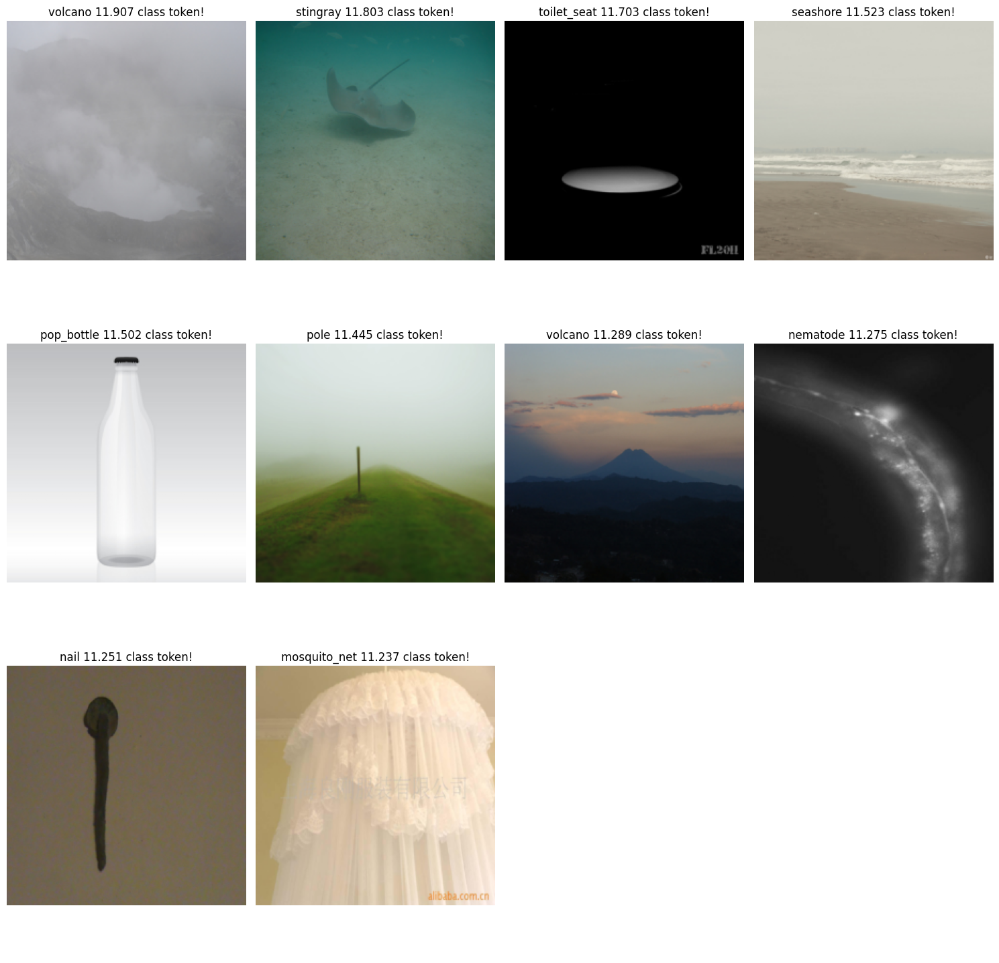

looking at 44546
tensor([7.7654, 7.6633, 7.6366, 7.4746, 7.4062, 7.3988, 7.3513, 7.3500, 7.3426,
        7.3358])


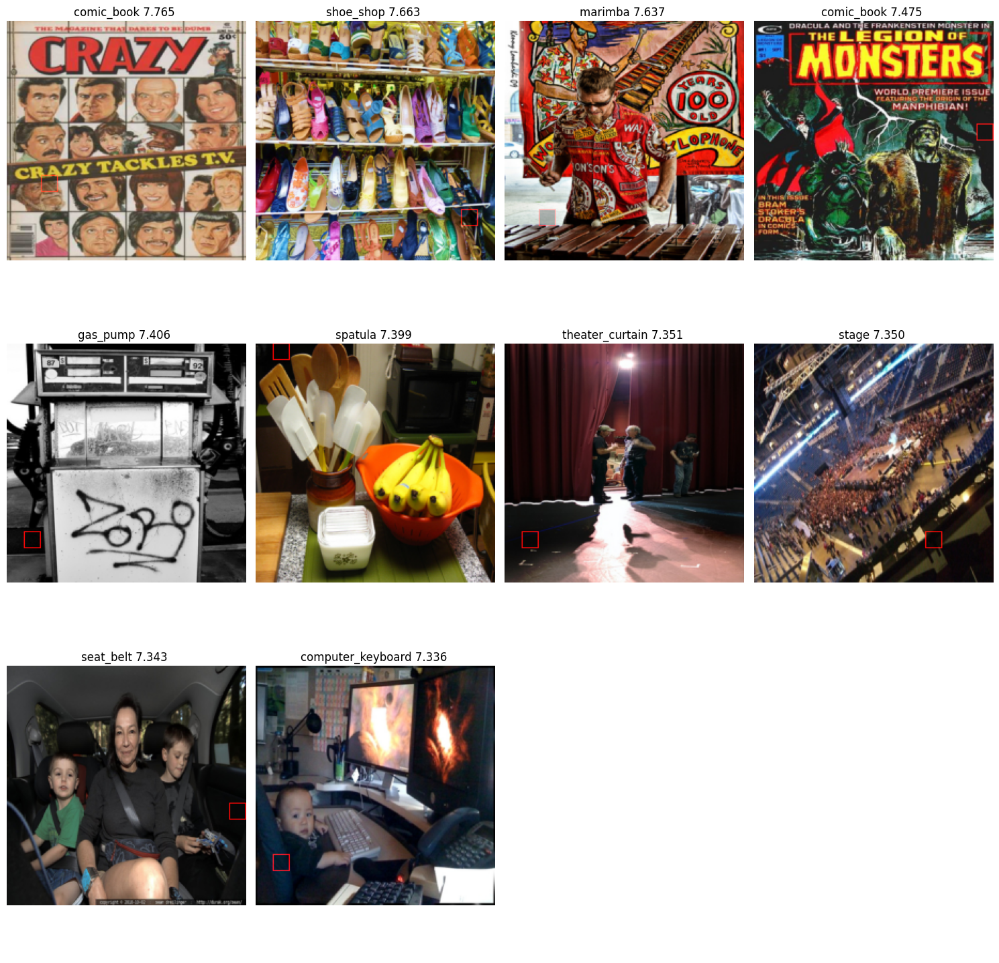

looking at 45082
tensor([8.8580, 8.7963, 8.7437, 8.7248, 8.6906, 8.6629, 8.6614, 8.6537, 8.6419,
        8.6123])


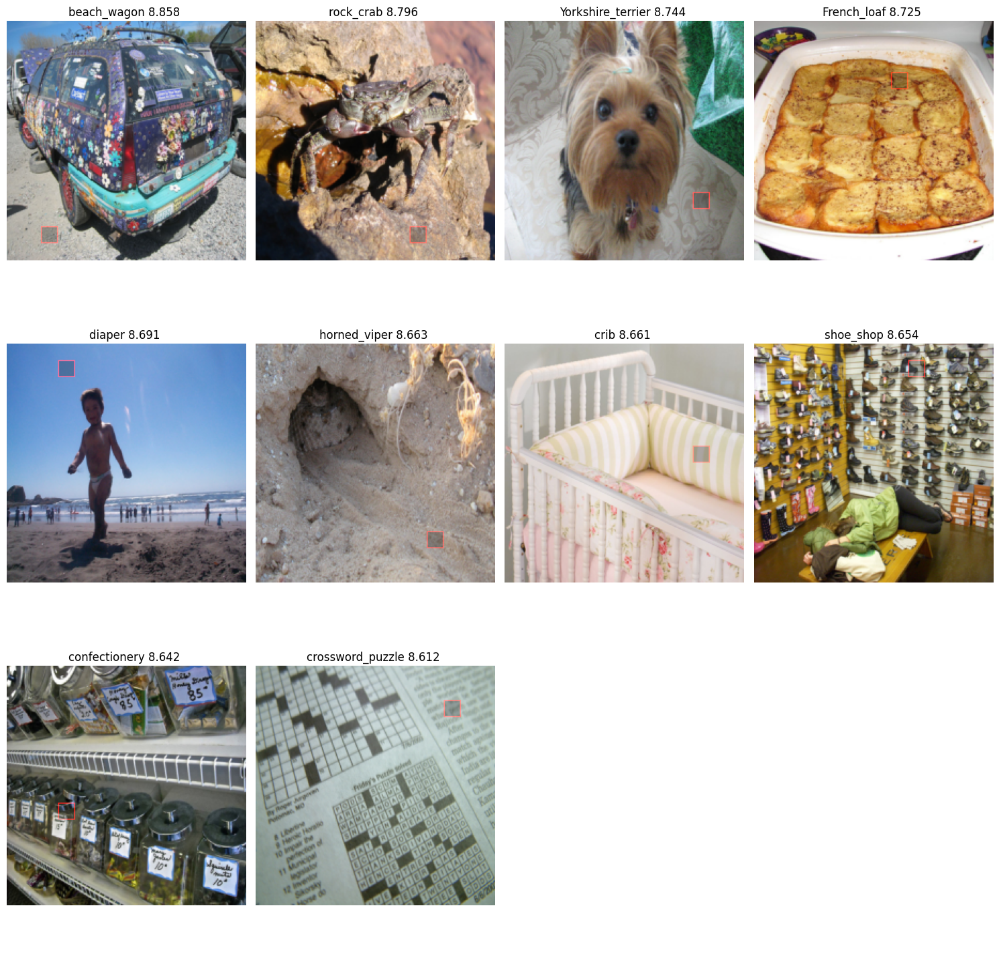

looking at 43473
tensor([3.7735, 3.6360, 3.6040, 3.5837, 3.5709, 3.5672, 3.5565, 3.5480, 3.5199,
        3.4861])


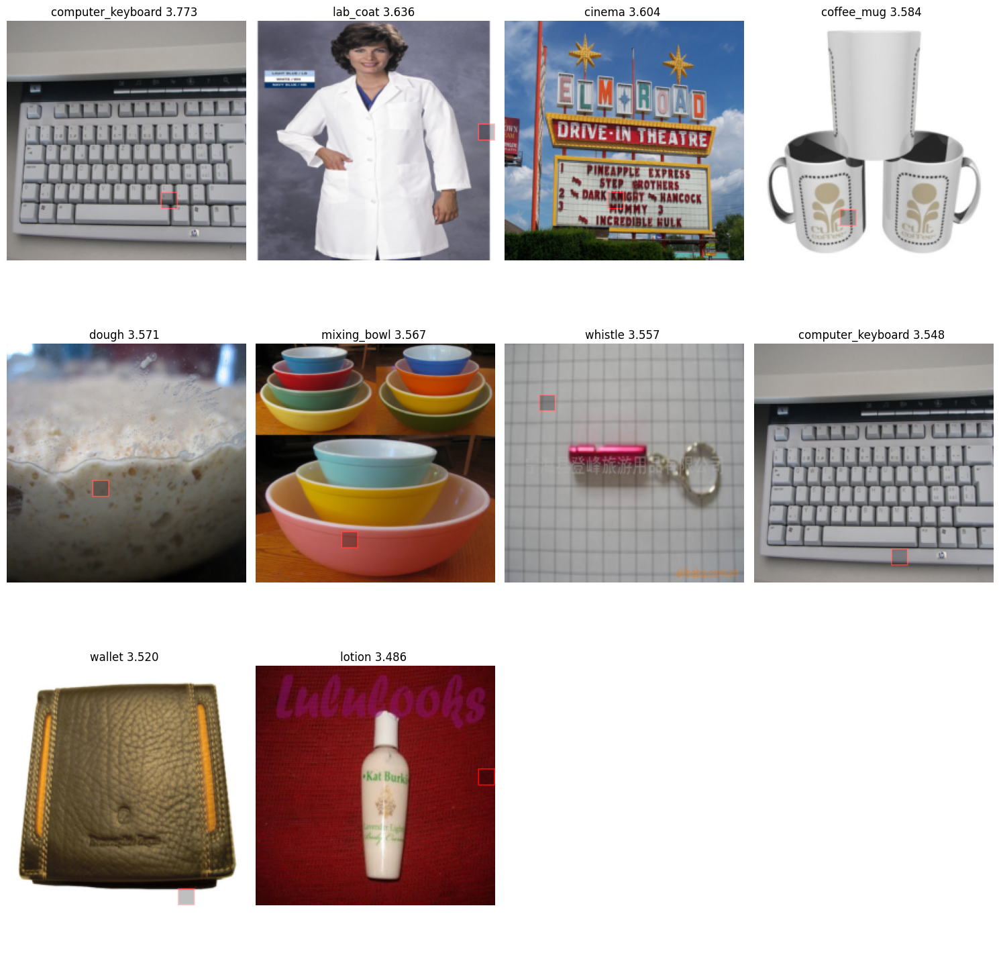

looking at 16009
tensor([4.7401, 4.5525, 4.3928, 4.2839, 4.2805, 4.2582, 4.2277, 4.2250, 4.1877,
        4.1607])


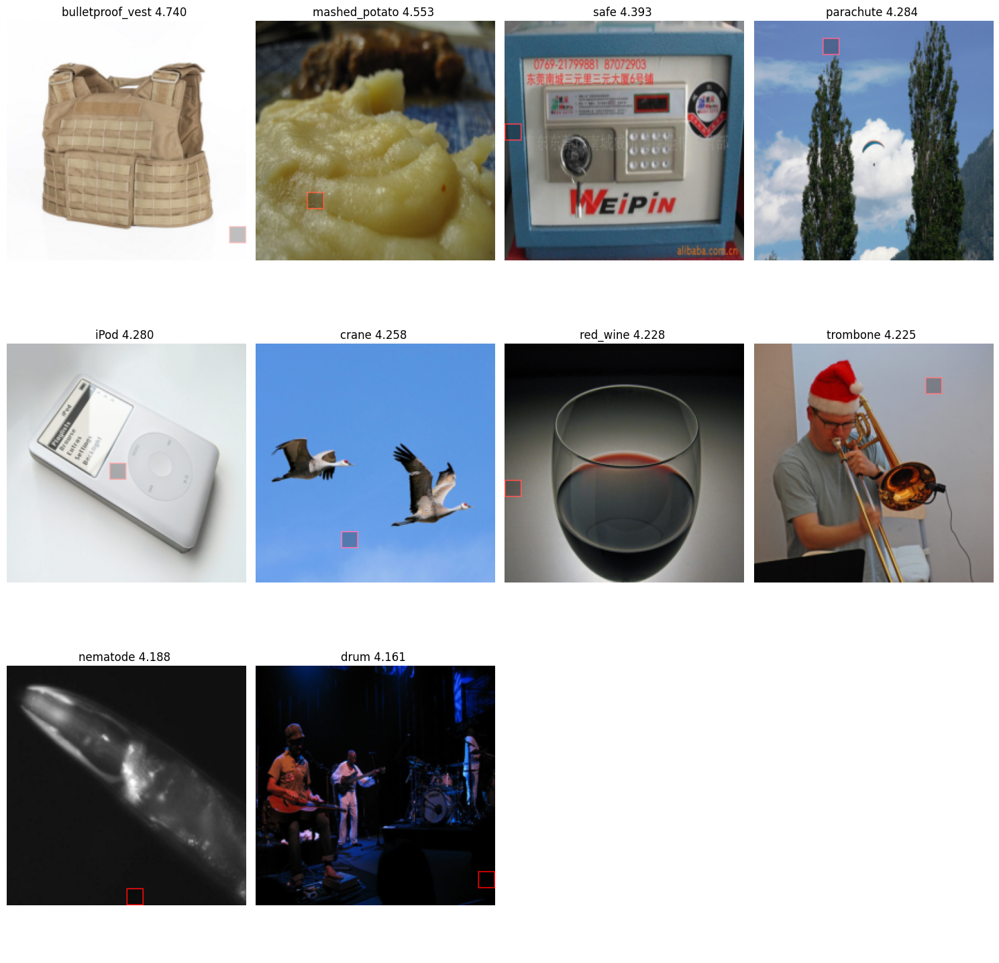

looking at 6688
tensor([2.8108, 2.7843, 2.7819, 2.7542, 2.7134, 2.6928, 2.6792, 2.6682, 2.6590,
        2.6431])


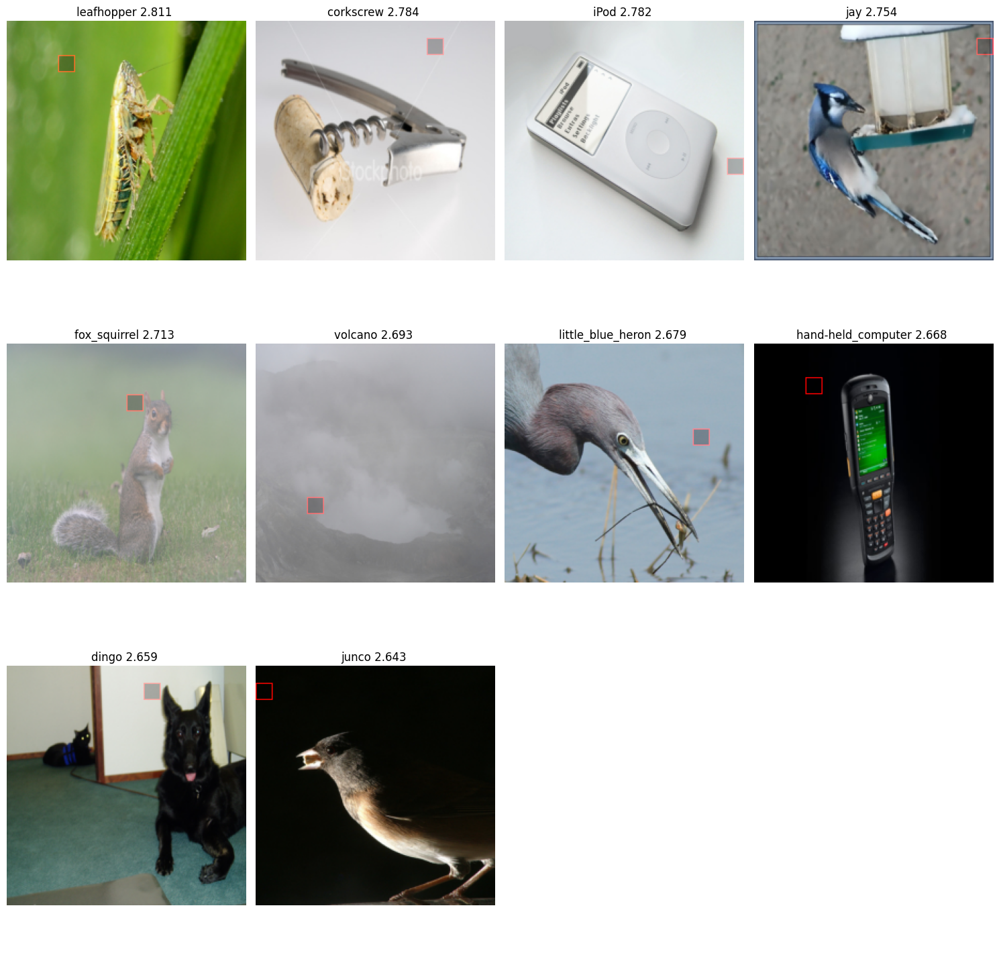

looking at 36984
tensor([4.4554, 4.2501, 4.2124, 4.1518, 4.0805, 4.0670, 4.0185, 3.9334, 3.9211,
        3.9146])


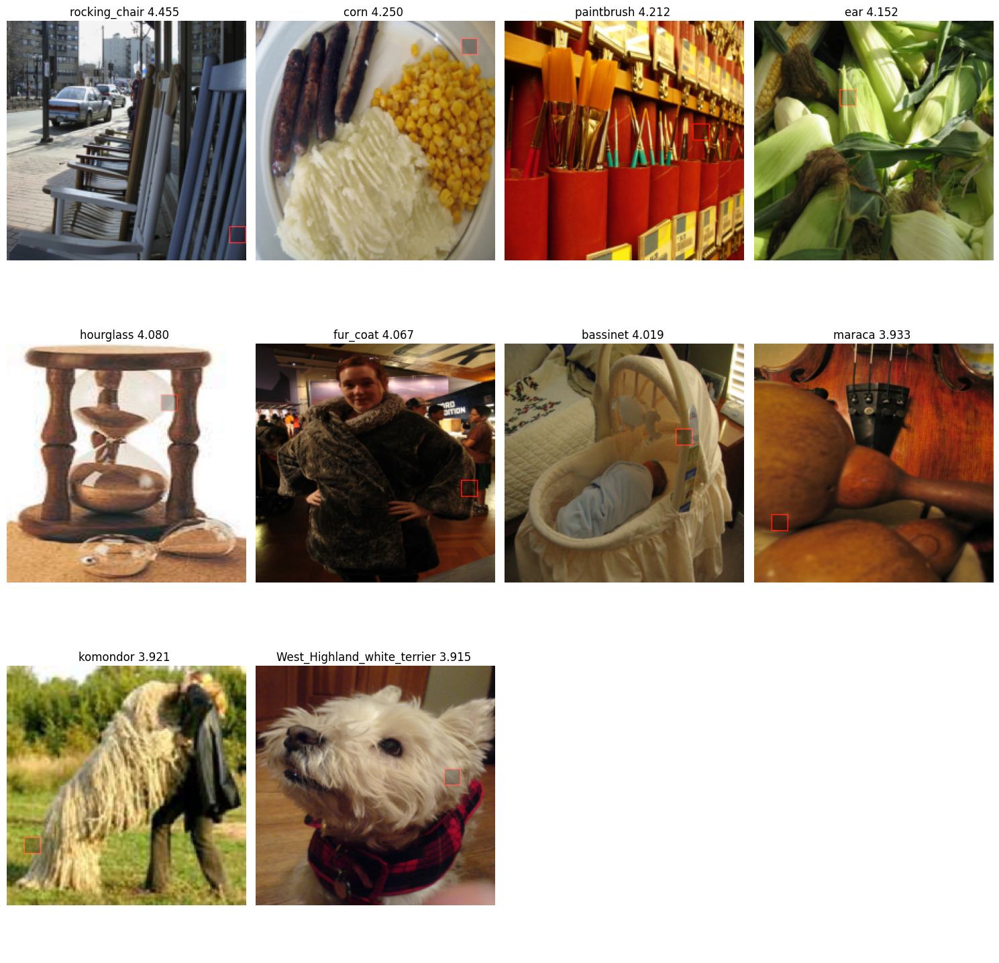

looking at 29396
tensor([6.0028, 5.6209, 5.5714, 5.4639, 5.3319, 5.0410, 5.0196, 4.9742, 4.9548,
        4.9218])


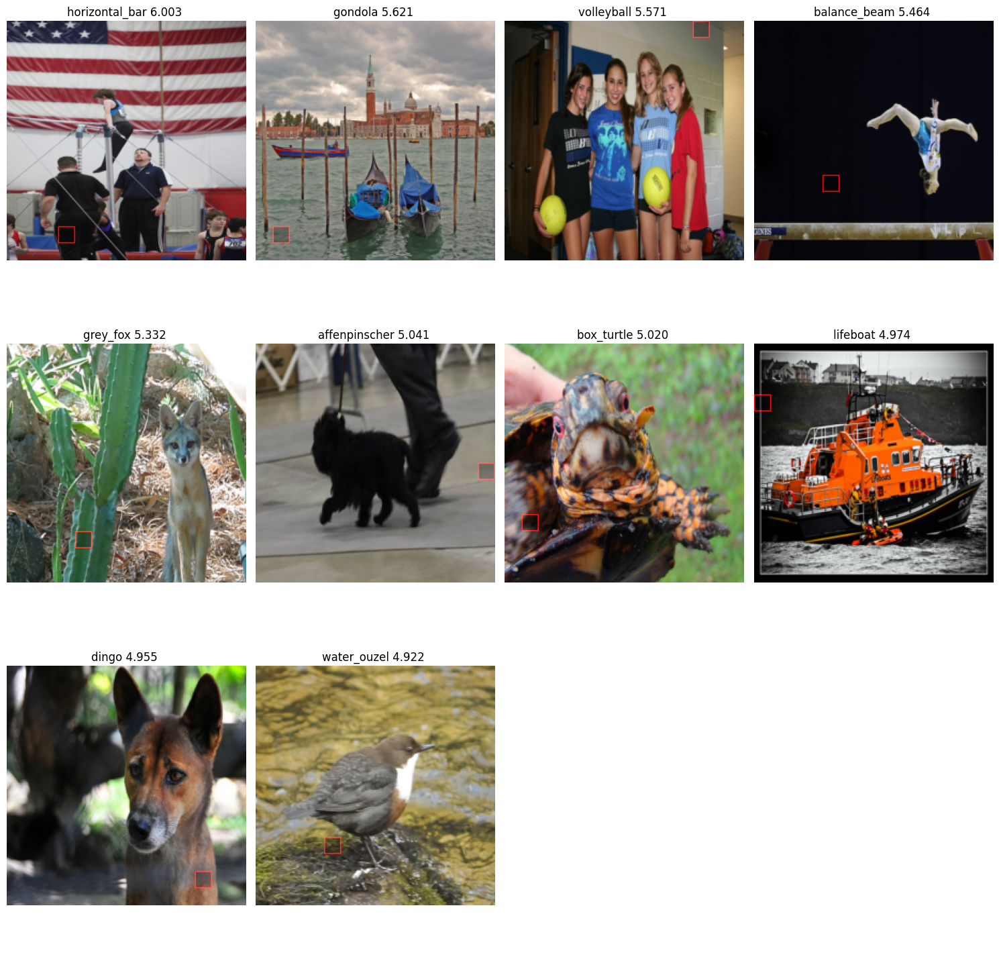

looking at 9715
tensor([7.6965, 7.6031, 7.4527, 7.3187, 7.3143, 7.2900, 7.2542, 7.1710, 7.0885,
        7.0883])


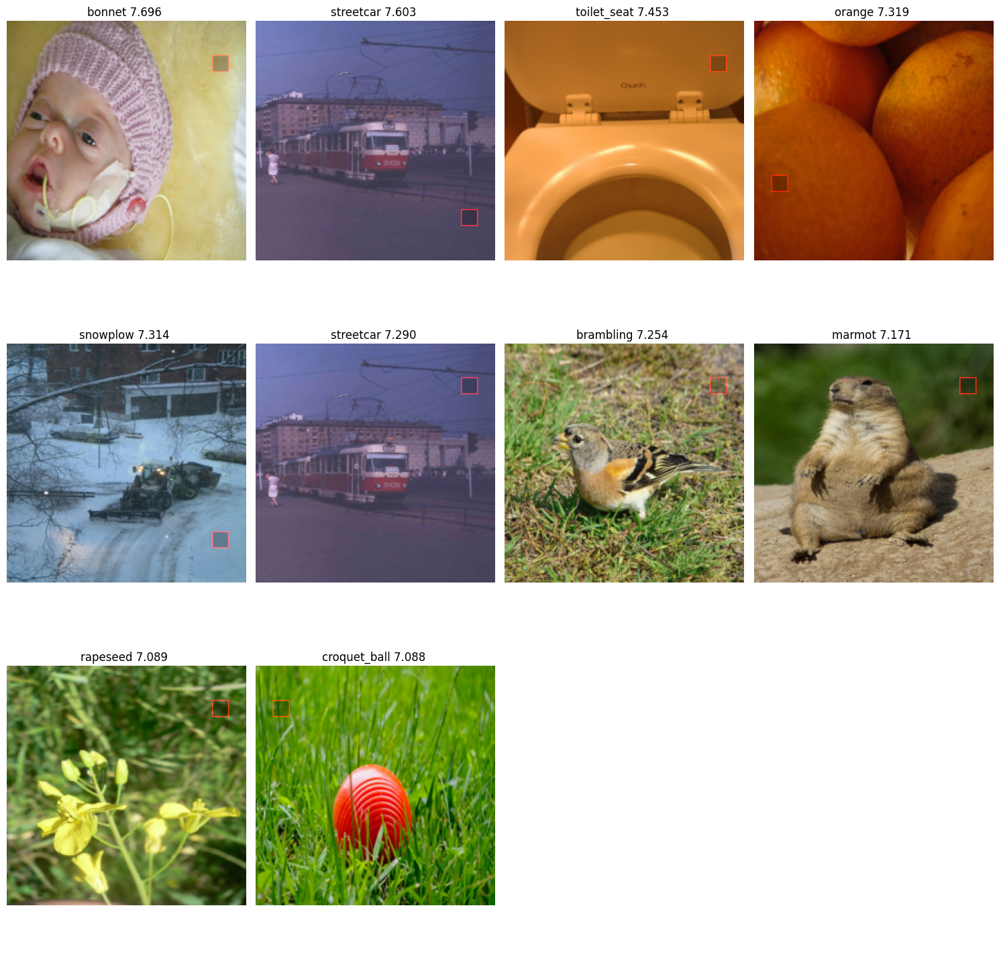

looking at 17149
tensor([6.9283, 6.5449, 6.5254, 6.4889, 6.4377, 6.3253, 6.2966, 6.2318, 6.2269,
        6.2059])


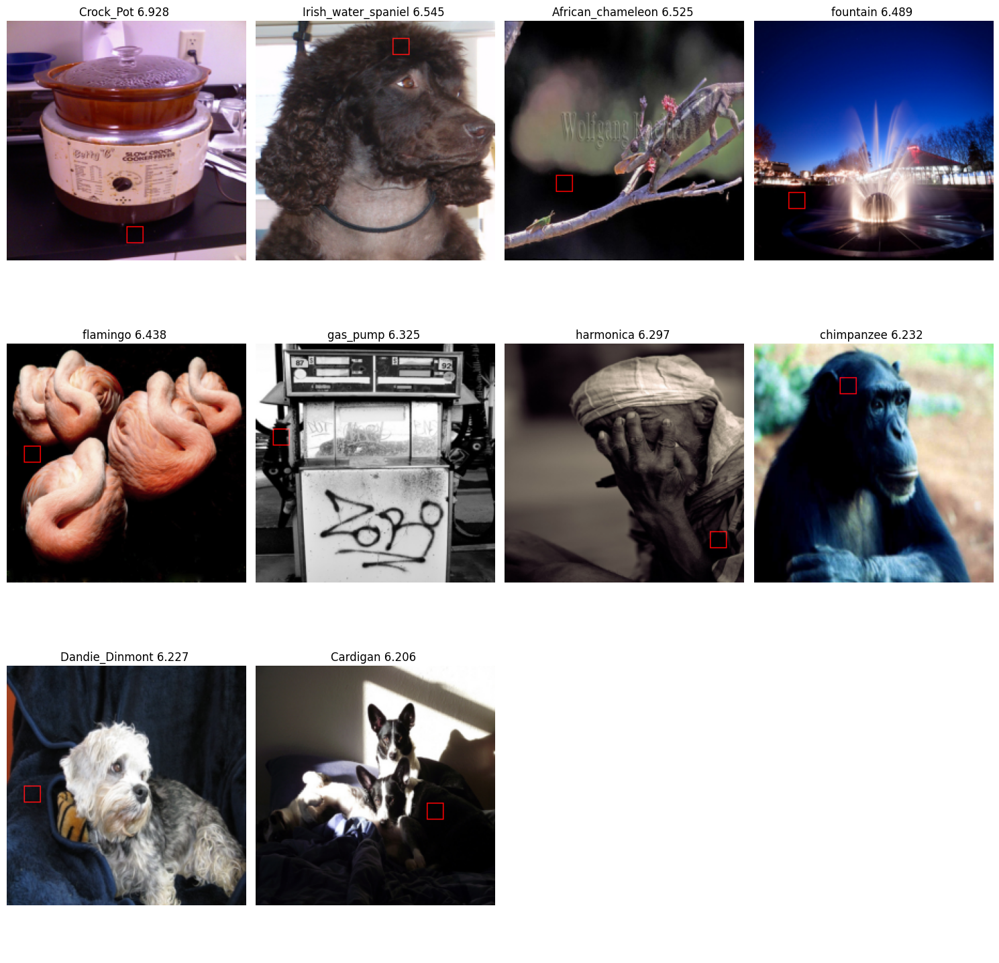

In [111]:
for feature_ids in top_per_feature.keys():
    print(f"looking at {feature_ids}")
    max_vals, max_inds = top_per_feature[feature_ids]
    images = []
    gt_labels = []
    print(max_vals)
    for id, v in zip(max_inds, max_vals):
        bid, pid = id 

        image, label, image_ind = imagenet_data[bid]

        
        assert image_ind.item() == bid
        images.append(image)
        gt_labels.append(ind_to_name[label])
    
    grid_size = int(np.ceil(np.sqrt(len(images))))
    fig, axs = plt.subplots(int(np.ceil(len(images)/grid_size)), grid_size, figsize=(15, 15))
    for ax in axs.flatten():
        ax.axis('off')
    for i, (image_tensor, label, val, id) in enumerate(zip(images, gt_labels, max_vals,max_inds )):




        row = i // grid_size
        col = i % grid_size
        
        display = image_tensor.numpy().transpose(1, 2, 0)

        bid, pid = id 
        if pid == 0:
            pass
        else:
            pid_r = (pid-1)//14
            pid_c = (pid-1)%14
            
            display[pid_r*16:(pid_r+1)*16, pid_c*16:(pid_c+1)*16,:] = display[pid_r*16:(pid_r+1)*16, pid_c*16:(pid_c+1)*16,:]*0.75 + 0.25*np.zeros_like(display[pid_r*16:(pid_r+1)*16, pid_c*16:(pid_c+1)*16,:])
            display[pid_r*16:(pid_r+1)*16, pid_c*16,0] = 1.0
            display[pid_r*16:(pid_r+1)*16, (pid_c+1)*16-1,0] = 1.0
            display[pid_r*16, pid_c*16:(pid_c+1)*16,0] =1.0
            display[(pid_r+1)*16-1, pid_c*16:(pid_c+1)*16,0]  =1.0


        axs[row, col].imshow(display)
        axs[row, col].set_title(f"{label} {val.item():0.03f} {'class token!' if pid==0 else ''}")  
        axs[row, col].axis('off')  

    plt.tight_layout()
    plt.show()
